In [56]:
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import os
import json
import datetime

In [15]:
pattern_length = 4

dataset = pd.read_csv("data/SEG_dataset_{}.csv".format(pattern_length))
dataset.head()

,delta,t,t+1
0,-1587653544,95444983808,93857330264
1,6172925864,87674650304,93847576168
2,-6187909720,93857313352,87669403632
3,-6187918552,93857325056,87669406504
4,-6198466584,93857330264,87658863680


In [16]:
from sklearn.model_selection import train_test_split

train_set, test_set = train_test_split(dataset, test_size=0.4, shuffle=False, random_state=42)

In [20]:
train_set["delta"].values.reshape(-1, 1)

array([[-1587653544],
       [ 6172925864],
       [-6187909720],
       ...,
       [      65536],
       [  -16673024],
       [      -5888]], dtype=int64)

In [21]:
from sklearn.preprocessing import MinMaxScaler
import joblib

minmax_scaler = MinMaxScaler()

train_set_scaled = minmax_scaler.fit_transform(train_set["delta"].values.reshape(-1, 1))
train_set_scaled

array([[0.39820164],
       [0.89577508],
       [0.10325391],
       ...,
       [0.49999905],
       [0.49892585],
       [0.49999447]])

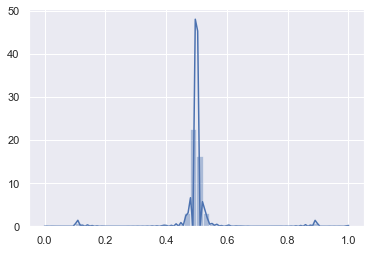

In [22]:
import seaborn as sns

sns.set(color_codes=True)
sns.distplot(train_set_scaled.reshape(1, -1)[0])

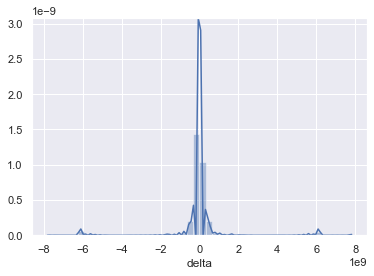

In [23]:
sns.distplot(train_set["delta"])

In [26]:
from scipy.stats import skew, kurtosis

skew(train_set["delta"]), kurtosis(train_set["delta"])

(0.05288563383736862, 14.854397200037294)

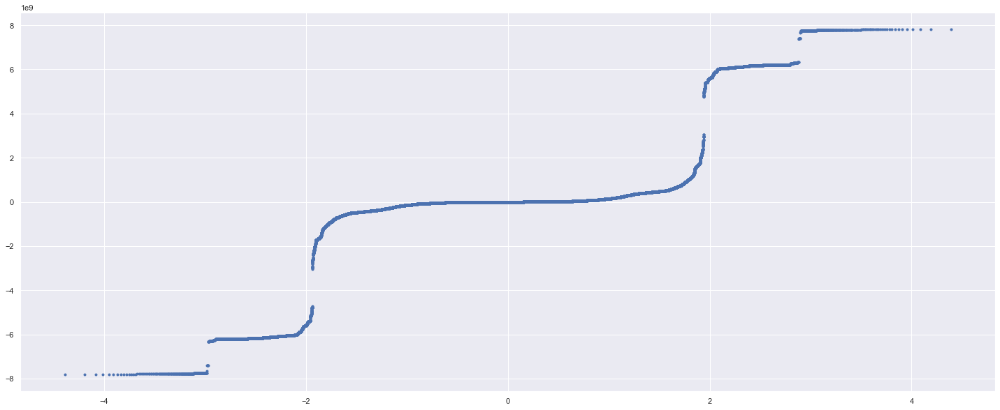

In [72]:
from scipy.stats import probplot

fig = plt.figure(figsize=(25, 10))
ax = fig.add_subplot(1, 1, 1)
osm, osr = probplot(train_set["delta"], fit=0, dist='norm')
ax.plot(osm, osr, '.')

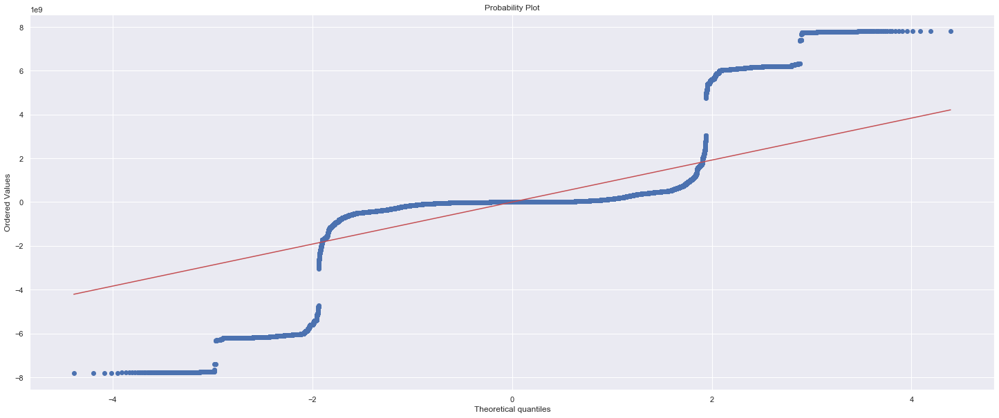

In [88]:
import scipy.stats as stats

fig = plt.figure(figsize=(25, 10))
ax = fig.add_subplot(111)
res = probplot(train_set["delta"], plot=ax)
plt.show()

In [94]:
from sklearn.preprocessing import PowerTransformer

pt = PowerTransformer()
train_set_pt = pt.fit_transform(train_set["delta"].to_numpy().reshape(-1, 1))

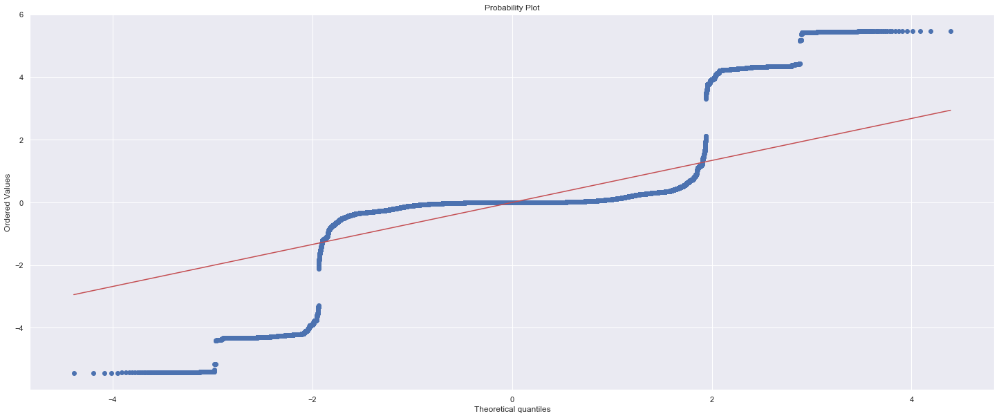

In [97]:
fig = plt.figure(figsize=(25, 10))
ax = fig.add_subplot(111)
res = probplot(train_set_pt.reshape(1, -1)[0], plot=ax)
plt.show()